In [67]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds

split: Which split of the data to load (e.g. 'train', 'test', ['train','test'], 'train[80%:]',...). See our split API guide. If None, will return all splits in a Dict[Split, tf.data.Dataset] 

as_supervised:	bool, if True, the returned tf.data.Dataset will have a 2-tuple structure (input, label) according to builder.info.supervised_keys. If False, the default, the returned tf.data.Dataset will have a dictionary with all the features.

In [68]:
dataset, dataset_info = tfds.load('malaria', with_info=True, as_supervised=True,shuffle_files=True,split=['train'])

In datasets which have preexisting test and train splits there we can use split=['train','test']

In [69]:
#dataset = tf.data.Dataset.range(10) # tf.data.Dataset gives a dataset with 10 elements - tf.data is a collection of elements that can be iterated over
#print(list(dataset.as_numpy_iterator())) # convert the dataset to a list and print it
#dataset = dataset.skip(7) # skip the first 7 elements of the dataset
#print(list((dataset.skip(7)).as_numpy_iterator())) # convert the dataset to a list and print it 
#dataset = dataset.take(6) # take the first 6 elements of the dataset
#print(list((dataset.take(6)).as_numpy_iterator())) # convert the dataset to a list and print it

# DATA PREPARATION

In [73]:
def split(dataset,TRAIN_RATIO,VAL_RATIO,TEST_RATIO):
    dataset_size = len(dataset)
    train_dataset = dataset.take(int(TRAIN_RATIO*dataset_size))
    val_dataset = dataset.skip(int(TRAIN_RATIO*dataset_size)).take(int(VAL_RATIO*dataset_size))
    test_dataset = dataset.skip(int((TRAIN_RATIO+VAL_RATIO)*dataset_size))
    return train_dataset,val_dataset,test_dataset

In [74]:
TRAIN_RATIO = 0.8
VAL_RATIO = 0.1
TEST_RATIO = 0.1

train_dataset,val_dataset,test_dataset = split(dataset[0],TRAIN_RATIO,VAL_RATIO,TEST_RATIO)
#dataset[0] because dataset is a dictionary with the key being the dataset name and the value being the dataset itself
#dataset[0] gives the dataset itself while dataset[1] gives the dataset info,types
print(list(train_dataset.as_numpy_iterator()))
print(list(val_dataset.as_numpy_iterator()))
print(list(test_dataset.as_numpy_iterator()))

[(array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8), 1), (array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
      

# DATA VISUALISATION

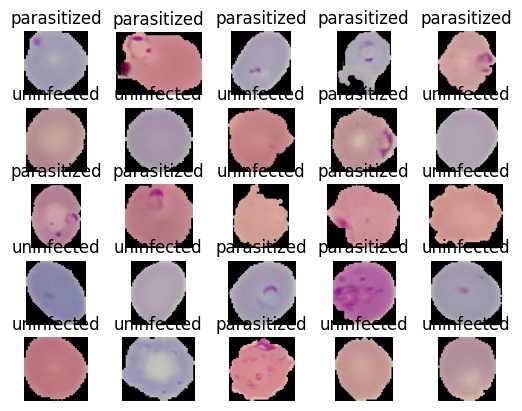

In [81]:
for i , (image,label) in enumerate(train_dataset.take(25)):
    ax = plt.subplot(5,5,i+1) # 4 rows and 4 columns cause we want to display 16 images
    plt.imshow(image)
    plt.title(dataset_info.features['label'].int2str(label)) # label is an integer so we convert it to a string (P or U)
    plt.axis('off') # turn off the axis of the plot (x and y axis)

In [82]:
dataset_info.features['label'].int2str(0) 

'parasitized'

# DATA PROCESSING

We gonna work on two parts here
* resizing the input image size ( converting 102*102 to fixed size so that all images irrespective of H & W will have same H & W (here it's 224))
* normalization,standardization
* x = x-u/s.d  standardization
* x = x - xmin/xmax-xmin  normalization ... in this case we are gonna use normalization

In [92]:
IM_SIZE = 224
def resize_rescale(image,label):
    return tf.image.resize(image,(IM_SIZE,IM_SIZE))/225.0,label
    

In [93]:
train_dataset = train_dataset.map(resize_rescale) # for preprocessing , how exactly? it applies a function to each element of the dataset

In [94]:
for image,label in train_dataset.take(6):
    print(image.shape)

(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)
(224, 224, 3)


now we gonna suffle our data, we gonna put them in batches and then we'll do prefetching

In [95]:
train_dataset = train_dataset.shuffle(buffer_size=8,reshuffle_each_iteration=True).batch(32).prefetch(tf.data.AUTOTUNE)

# HOW AND WHY CONVNETS WORK